# The Traveling Salesperson Problem
The [Traveling Salesperson Problem](https://en.wikipedia.org/wiki/Travelling_salesman_problem) is a classic optimization problem dating back to 1832. The problem asks for the shortest route visiting all cities in an area. The Jupyter Notebook that generated this document will be available [here]( https://github.com/davidbailey/tum/blob/master/Traveling%20Salesperson%20Problem.ipynb) after the submission deadline.

In [75]:
import pandas
pandas.set_option('display.max_rows', 10000)
pandas.set_option('display.max_columns', 10000)
pandas.set_option('display.max_colwidth', 10000)
import requests
import bs4
import numpy
from haversine import haversine
from functools import partial, reduce
from multiprocessing import Pool
from pyspark import SparkContext, SparkConf
import cvxpy as cvx
import networkx
from random import random, sample, choices
import time
from matplotlib import pyplot
pyplot.style.use('ggplot')
from cartopy.io.img_tiles import StamenTerrain
import cartopy.crs as ccrs
from shapely.geometry import LineString
from shapely.geometry import Point
import geopandas
import matplotlib.patheffects as path_effects
from textwrap import fill

## Getting Data
First, we need data. Primarily, we need the locations of the cities we would like our salesperson to visit. We could get this information from Open Street Maps, but Wikipedia includes other information like the population of each city. To automate the process of downloading this data from Wikipedia, we build a function, getTableFromWikipedia. This function takes a Wikipedia page's url and the number of the table on the page (for pages with more than one table) and provides us with a nicely formatted Pandas DataFrame. We use this function to download the list of cities in Germany by population. Because the data is in a DataFrame we can use Pandas' apply function to create longitude and latitude columns in the right format for our distance functions. We also download the States of Germany wikipedia table and use this information combined with our first DataFrame to create our different test cases.

In [76]:
def getTableFromWikipedia(url, number):
    r = requests.get(url)
    soup = bs4.BeautifulSoup(r._content, 'html.parser')
    columns = list(map(bs4.element.Tag.getText, soup.find_all('table')[number].find_all('tr')[0].find_all(['td', 'th'])))
    rows = list(map(lambda row: list(map(bs4.element.Tag.getText, row.find_all(['td', 'th']))), soup.find_all('table')[number].find_all('tr')))
    dataframe = pandas.DataFrame(rows, columns=columns)
    dataframe.drop(0, inplace=True)
    return dataframe

In [77]:
citiesByPopulation = getTableFromWikipedia(url='https://en.wikipedia.org/wiki/List_of_cities_in_Germany_by_population', number=0)
citiesByPopulation['2015 Estimate'] = citiesByPopulation['2015 Estimate'].str.replace(',', '').apply(int)
citiesByPopulation.index = citiesByPopulation.City
citiesByPopulation['Location'] = citiesByPopulation['Location'].str.split('/').str[1]
citiesByPopulation['latitude'] = citiesByPopulation['Location'].apply(lambda row: float(row.replace('\ufeff', '').split(' ')[1].split('°')[0]))
citiesByPopulation['longitude'] = citiesByPopulation['Location'].apply(lambda row: float(row.replace('\ufeff', '').split(' ')[2].split('°')[0]))
citiesByPopulation.head()

,2015 rank,City,State,2015 Estimate,2011 Census,Change,2015 land area,2015 population density,Location,latitude,longitude
City,,,,,,,,,,,
Berlin,1,Berlin,Berlin,3520031,"3,292,365",7000691496841935810♠+6.91%,891.68 km2\n344.28 sq mi,"3,948/km2\n10,230/sq mi",﻿52.50722°N 13.14583°E﻿,52.50722,13.14583
Hamburg,2,Hamburg,Hamburg,1787408,"1,706,696",7000472913746794980♠+4.73%,755.3 km2\n291.6 sq mi,"2,366/km2\n6,130/sq mi",﻿53.54861°N 10.00139°E﻿,53.54861,10.00139
München (Munich),3,München (Munich),Bavaria,1450381,"1,348,335",7000756829719617160♠+7.57%,310.7 km2\n120.0 sq mi,"4,668/km2\n12,090/sq mi",﻿48.133°N 11.567°E﻿,48.13300,11.56700
Köln (Cologne),4,Köln (Cologne),North Rhine-Westphalia,1060582,"1,005,775",7000544923069274940♠+5.45%,405.02 km2\n156.38 sq mi,"2,619/km2\n6,780/sq mi",﻿50.93639°N 6.95278°E﻿,50.93639,6.95278
Frankfurt am Main,5,Frankfurt am Main,Hesse,732688,"667,925",7000969614851966910♠+9.70%,248.31 km2\n95.87 sq mi,"2,951/km2\n7,640/sq mi",﻿50.117°N 8.683°E﻿,50.11700,8.68300


In [78]:
states = getTableFromWikipedia(url='https://en.wikipedia.org/wiki/States_of_Germany', number=2)
states['State'] = states['State'].str.split('\n').str[0]
states['Population'] = states['Population'].str.replace(',', '').apply(int)
states.head()

,Coat of arms,Flag,State,Part of FRG since,Head of government,Image,Government coalition,Bundes rat votes,Area (km2),Population,Pop. per km2,Capital,ISO 3166-2 code,GDP per Capita in Euro
1,,,Baden-Württemberg,1952[7],Winfried Kretschmann (Greens),,"Greens, CDU",6,"35,752",10755000,301,Stuttgart,BW,"34,885"
2,,,Bavaria,1949,Horst Seehofer (CSU),,CSU,6,"70,552",12542000,178,Munich\n(München),BY,"35,443"
3,,,Berlin,1990[8],Michael Müller (SPD),,"SPD, Greens, The Left",4,892,3469000,"3,890",–,BE,"28,806"
4,,,Brandenburg,1990,Dietmar Woidke (SPD),,"SPD, The Left",4,"29,479",2500000,85,Potsdam,BB,"22,074"
5,,,Bremen,1949,Carsten Sieling (SPD),,"SPD, Greens",3,419,661000,"1,577",Bremen,HB,"42,405"


In [79]:
smallestEightStates = states.sort_values('Population').head(8)['State']
biggestCityInEachState = citiesByPopulation[citiesByPopulation['2015 Estimate'].isin(citiesByPopulation.groupby('State')['2015 Estimate'].max())]
biggestCityInEachState.name = 'Biggest City in Each State'
biggestCityInSmallestEightStates = biggestCityInEachState[biggestCityInEachState['State'].isin(smallestEightStates)]
biggestCityInSmallestEightStates.name = 'Biggest City in Each of the Smallest Eight States'
citiesOver200000 = citiesByPopulation[citiesByPopulation['2015 Estimate'] > 200000]
citiesOver200000.name = 'Cities with Population over 200,000'

## Distance Matrices
A distance matrix provides us with a quick way to lookup the distance between cities. Each column represents an origin city and each row represents a destination city. (This is backwards of how we often write a distance matrix, but it fits better with selection operations in Pandas.)

### distanceHaversine
The simpliest way to compute this distance is to draw a straight line from each city to each other city. Here we use the [Haversine formula](https://en.wikipedia.org/wiki/Haversine_formula) to calculate the distance between two latitude/longitude coordinates in kilometers.

### distanceOSRM
However, in reality we cannot drive in a straight line between each city: we drive along roads. To compute the fastest distance along the road network we can use the [Open Source Routing Machine](https://en.wikipedia.org/wiki/Open_Source_Routing_Machine) (OSRM). This software is a open source version of a routing engine like to Google Maps. It uses Open Street Map data we can download from [GEOFABRIK](http://download.geofabrik.de/europe/germany.html). Here are the commands for necessary to run OSRM on macOS:

```
brew install osrm-backend
curl http://download.geofabrik.de/europe/germany-latest.osm.pbf -o germany-latest.osm.pbf
osrm-extract -p /usr/local/var/homebrew/linked/osrm-backend/share/osrm-backend/profiles/car.lua germany-latest.osm.pbf
osrm-contract germany-latest.osrm
osrm-routed germany-latest.osrm
```

Now we have an HTTP API running locally where we can find the fastest route (and more importantly distance) between each pair of cities based on the road network. 

In [80]:
def distanceHaversine(city1, city2):
    return haversine((city1['latitude'], city1['longitude']), (city2['latitude'], city2['longitude']))


def distanceOSRM(city1, city2):
    r = requests.get('http://localhost:5000/route/v1/driving/' + str(city1['longitude']) + ',' + str(city1['latitude']) + ';' + str(city2['longitude']) + ',' + str(city2['latitude']))
    return float(r.json()['routes'][0]['distance'])/1000


def distanceMatrixGenerator(cities, function):
    return cities.apply(lambda city: cities.apply(partial(function, city), axis=1), axis=1)

## Traveling Salesperon Function
To simplify our reporting below, we create one function to test all of our methods of solving the Traveling Salesperson Problem. This function computes the distance matrix, runs each method with the right parameters, and measures the computation time for each method.

In [81]:
def travelingSalesperson(function, distanceFunction, cities, originCity='München (Munich)', costPerKM=35):
    if originCity not in cities.City:
        name = cities.name
        cities = cities.append(citiesByPopulation.loc[originCity])
        cities.name = name
    startTime = time.time()
    distanceMatrix = distanceMatrixGenerator(cities, distanceFunction)
    out = function(originCity, distanceMatrix, cities)
    computationTime = time.time() - startTime
    return {
        'Cost (Euros)': round(out['cost'] * costPerKM, 2),
        'Route': out['route'],
        'Computation Time (seconds)': round(computationTime, 2),
        'Method': function.__name__ ,
        'Distance Method': distanceFunction.__name__,
        'Number of Cities': len(cities),
        'City Selection' : cities.name
    }

## Exact Method 1: Recursion with Pandas
In our first four methods, we use a [recursion](https://en.wikipedia.org/wiki/Recursion_(computer_science) function to compute all possible paths for our salesperson. We then compare the distances between all the possible paths and choose the path with the shortest distance. This method ensures we find the shortest path, but it also takes the maximum possible time. We have to compute n! paths where n is the number of cities.

In [82]:
def recursionPandas(city, cities, previousCity, cost, route, originCity, distanceMatrix):
    cities = cities.drop(city.City)
    route = list(route)
    route.append(city.City)
    cost = cost + distanceMatrix[previousCity.City][city.City]
    if cities.empty:
        cost = cost + distanceMatrix[city.City][originCity.City]
        route.append(originCity.City)
        return {'cost': cost, 'route': route}
    else:
        out = cities.apply(partial(recursionPandas, cities=cities, previousCity=city, cost=cost, route=route, originCity=originCity, distanceMatrix=distanceMatrix), raw=True, axis=1)
        return reduce((lambda x, y: x if x['cost'] < y['cost'] else y), out)


def recursionPandasMethod(originCity, distanceMatrix, cities):
    return recursionPandas(citiesByPopulation.loc[originCity], cities, citiesByPopulation.loc[originCity], 0.0, [], citiesByPopulation.loc[originCity], distanceMatrix)

## Exact Method 2: Recursion with NumPy
Our second method is functionally the same as our first method, but relies on the NumPy arrays instead of Pandas DataFrames. In our results we see that this version is much faster than the first method, most likely because NumPy does not include any of the added complexity that Pandas provides.

In [83]:
def recursionNumpy(city, cities, previousCity, cost, route, originCity, distanceMatrix):
    cities = list(cities)
    cities.remove(city)
    route = list(route)
    route.append(city)
    cost = cost + distanceMatrix[previousCity][city]
    if len(cities) > 0:
        out = map(partial(recursionNumpy, cities=cities, previousCity=city, cost=cost, route=route, originCity=originCity, distanceMatrix=distanceMatrix), cities)
        return reduce((lambda x, y: x if x['cost'] < y['cost'] else y), out)
    else:
        cost = cost + distanceMatrix[city][originCity]
        route.append(originCity)
        return {'cost': cost, 'route': route}


def recursionNumpyMethod(originCity, distanceMatrix, cities):
    originCity = cities.index.get_loc(originCity)
    citiesNumpy = list(range(len(cities)))
    distanceMatrix = distanceMatrix.values
    out = recursionNumpy(originCity, citiesNumpy, originCity, 0.0, [], originCity, distanceMatrix)
    out['route'] = list(map(lambda x: cities.iloc[x]['City'], out['route']))
    return out

## Exact Method 3: Recursion with NumPy and Mulitprocessing
Our third method is the same as the second method, but adds multiprocessing capabilities. Our recursion function is perfect for multiprocessing because it follows the [MapReduce](https://en.wikipedia.org/wiki/MapReduce) model. With multiprocessing we can use all of the available cores on our computer to speed up the function. Note this function does not call itself recursively, but rather calls our other NumPy function. This is to limit the number of threads to 8, not n!.

In [84]:
def recursionNumpyMultiprocessing(city, cities, previousCity, cost, route, originCity, distanceMatrix):
    cities = list(cities)
    cities.remove(city)
    route = list(route)
    route.append(city)
    cost = cost + distanceMatrix[previousCity][city]
    if len(cities) > 0:
        p = Pool(8)
        out = p.map(partial(recursionNumpy, cities=cities, previousCity=city, cost=cost, route=route, originCity=originCity, distanceMatrix=distanceMatrix), cities)
        return reduce((lambda x, y: x if x['cost'] < y['cost'] else y), out)
    else:
        cost = cost + distanceMatrix[city][originCity]
        route.append(originCity)
        return {'cost': cost, 'route': route}


def recursionNumpyMultiprocessingMethod(originCity, distanceMatrix, cities):
    originCity = cities.index.get_loc(originCity)
    citiesNumpy = list(range(len(cities)))
    distanceMatrix = distanceMatrix.values
    out = recursionNumpyMultiprocessing(originCity, citiesNumpy, originCity, 0.0, [], originCity, distanceMatrix)
    out['route'] = list(map(lambda x: cities.iloc[x]['City'], out['route']))
    return out

## Exact Method 4: Recursion with NumPy and Apache Spark
Our fourth method is again the same as earlier methods, but instead of using Python's multiprocessing library for distributing the workload we use [Apache Spark](https://en.wikipedia.org/wiki/Apache_Spark), a distributed computing framework based on Apache Hadoop. While the raw performance of Spark is often less than the multiprocessing method because of the additional overhead of the framework, Spark allows us to distribute our workload to a cluster of computers. This cluster could be on our local network or rented from a provider such as Amazon Web Services. Note that to make Spark run the correct version of Python you may have to open this notebook with the command below.
```
PYSPARK_PYTHON=python3 PYSPARK_DRIVER_PYTHON=ipython PYSPARK_DRIVER_PYTHON_OPTS="notebook" pyspark

or

/usr/local/var/homebrew/linked/apache-spark/libexec/sbin/start-master.sh --host localhost
/usr/local/var/homebrew/linked/apache-spark/libexec/sbin/start-slave.sh spark://localhost:7077
PYSPARK_PYTHON=python3 PYSPARK_DRIVER_PYTHON=ipython PYSPARK_DRIVER_PYTHON_OPTS="notebook" notebook


```

In [85]:
def recursionNumpySpark(city, cities, previousCity, cost, route, originCity, distanceMatrix, sc):
    cities = list(cities)
    cities.remove(city)
    route = list(route)
    route.append(city)
    cost = cost + distanceMatrix[previousCity][city]
    if len(cities) > 0:
        return sc.parallelize(cities).map(partial(recursionNumpy, cities=cities, previousCity=city, cost=cost, route=route, originCity=originCity, distanceMatrix=distanceMatrix)).reduce(lambda x, y: x if x['cost'] < y['cost'] else y)
    else:
        cost = cost + distanceMatrix[city][originCity]
        route.append(originCity)
        return {'cost': cost, 'route': route}


def recursionNumpySparkMethod(originCity, distanceMatrix, cities):
    sc = SparkContext.getOrCreate() # use this line if launching pyspark
    # sc = SparkContext('spark://localhost:7077', 'tsp') # use this line if launching master and slaves manually
    originCity = cities.index.get_loc(originCity)
    citiesNumpy = list(range(len(cities)))
    distanceMatrix = distanceMatrix.values
    out = recursionNumpySpark(originCity, citiesNumpy, originCity, 0.0, [], originCity, distanceMatrix, sc)
    out['route'] = list(map(lambda x: cities.iloc[x]['City'], out['route']))
    sc.stop()
    return out

## Exact Method 5: Integer Linear Programming
All of the above methods are [brute force methods](https://en.wikipedia.org/wiki/Proof_by_exhaustion). As we will see in the results, brute force methods are no match for even simple problems. However, with modern optimization techniques, we can find exact solutions to these problems rather quickly. By formulating the problem as an [Integer](https://en.wikipedia.org/wiki/Integer_programming) [Linear Programming](https://en.wikipedia.org/wiki/Linear_programming) problem, we can use solvers such as [GLPK](https://en.wikipedia.org/wiki/GNU_Linear_Programming_Kit). The following code starts with basic constraints that allows for subtours. It then runs interitavely and adds an additional constraint whenever a subtour is found. Whenever the routine finishes with no subtours, it provides the final result.

In [86]:
def A2Generator(size, i):
    i = i - 1
    if i:
        return numpy.concatenate((A2Generator(size, i), numpy.eye(size)), axis=1)
    else:
        return numpy.eye(size)


def subTourFinder(routeMatrix, size):
    citiesVisited = []
    originCity = 0
    currentCity = 0
    while len(citiesVisited) < size - 1:
        citiesVisited.append(currentCity)
        currentCity = routeMatrix[currentCity].index(1)
        if currentCity == originCity:
            return citiesVisited
    return False


def integerLinearMethod(originCity, distanceMatrix, cities, solver='GLPK_MI'):
    size = len(cities)
    A1 = numpy.eye(size).repeat(size, 1)
    A2 = A2Generator(size, size)
    position = 0
    for row in range(size):
        A1[row, row * size + position] = 0
        A2[row, row * size + position] = 0
        position += 1
    A_eq = numpy.concatenate((A1, A2))
    b_eq = numpy.ones(size * 2)
    c = distanceMatrix.values.reshape(size**2)
    x = cvx.Int(size**2)
    objective = cvx.Minimize(c * x)
    constraints = [A_eq * x == b_eq, x >= 0, x <=1]
    for i in range(size):
        constraints.append(x[i * size + i] == 0)
    prob = cvx.Problem(objective, constraints)
    prob.solve(solver=solver)
    route = x.value.reshape(size,size).round().tolist()
    subTour = subTourFinder(route, size)
    while subTour:
        newCondition = numpy.zeros([size,size])
        otherHalf = set(range(size)) - set(subTour)
        for i in subTour:
            for j in otherHalf:
                newCondition[i][j] = 1
        A_ub = newCondition.reshape(1,size**2)
        b_ub = [1]
        constraints.append(A_ub * x >= b_ub)
        prob = cvx.Problem(objective, constraints)
        prob.solve(solver=solver)
        route = x.value.reshape(size,size).round().tolist()
        subTour = subTourFinder(route, size)
    routeText = []
    currentCity = 0
    while len(routeText) <= size:
        routeText.append(cities.index[currentCity])
        currentCity = route[currentCity].index(1)
    return {'cost': prob.value, 'route': routeText}

## Heuristic Method 1: Nearest Neighbor
[Nearest Neighbor](https://en.wikipedia.org/wiki/Nearest_neighbor_search) is a very simple method that chooses the nearest unvisitied city at each step. This is a [greedy algorithm](https://en.wikipedia.org/wiki/Greedy_algorithm) that may or more likely not find the optimal route but is quite fast compared with the other methods. 

In [87]:
def nearestNeighbor(city, cost, route, distanceMatrix, originCity, finalDistanceMatrix):
    distanceMatrix = distanceMatrix.drop(city)
    route.append(city)
    if distanceMatrix.empty:
        cost = cost + finalDistanceMatrix[city][originCity]
        route.append(originCity)
        return {'cost': cost, 'route': route}
    else:
        nextCity = distanceMatrix[city].argmin()
        cost = cost + distanceMatrix[city][nextCity]
        return nearestNeighbor(city=nextCity, cost=cost, route=route, distanceMatrix=distanceMatrix, originCity=originCity, finalDistanceMatrix=finalDistanceMatrix)

def nearestNeighborMethod(originCity, distanceMatrix, cities):
    return nearestNeighbor(originCity, 0.0, [], distanceMatrix, originCity, distanceMatrix)

## Heuristic Method 2: Ant Colony Optimization
[Any Colony Optimization](https://en.wikipedia.org/wiki/Ant_colony_optimization_algorithms) is a method based on the natural behavior of ants. When ants travel between a food source and their colony, they leave behind a pheromone. Therefore the shorter paths will have a higher density of ants and a higher amount of pheromone. Future ants are then more likely to take the shorter path. The following algorythm is based on Ant Colony System created by Marco Dorigo and Luca Maria Gambardella in their paper *[Ant Colony System: A Cooperative Learning Approach to the Traveling Salesman Problem](http://ieeexplore.ieee.org/document/585892/)*. Note that because the number of ants is set to 10, the algorythm only works for problems with 10 or more cities.

In [88]:
def buildGraph(cities, distanceMatrix, initialPheromone):
    G = networkx.DiGraph()
    G.add_nodes_from(cities.index)
    for city1 in cities.index:
        for city2 in cities.index:
            G.add_edge(city1, city2, distance = distanceMatrix[city1][city2], pheromone=initialPheromone)
    return(G)


def probability(G, r, s, citiesRemaining, distanceMatrix, beta):
    probabilitySum = 0.0
    for u in citiesRemaining:
        probabilitySum += G[r][u]['pheromone'] * distanceMatrix[r][u]**beta
    return (G[r][s]['pheromone'] * distanceMatrix[r][s]**beta) / probabilitySum


def antColonyMethod(originCity, distanceMatrix, cities):
    loops = 1250
    initialPheromone = 1 / (nearestNeighborMethod(originCity, distanceMatrix, cities)['cost'] * len(cities))
    numberOfAnts = 10
    beta = -2
    p = .1
    q = .9
    alpha=.1
    deltaPheromone = initialPheromone
    G = buildGraph(cities, distanceMatrix, initialPheromone)
    for counter in range(loops):
        ants = sample(list(cities.index), numberOfAnts)
        routes = {}
        for originCity in ants:
            distance = 0.0
            citiesRemaining = list(cities.index)
            citiesRemaining.remove(originCity)
            route = list()
            route.append(originCity)
            currentCity = originCity
            while citiesRemaining:
                if random() <= q:
                    possibleNextCities = {}
                    for possibleNextCity in citiesRemaining:
                        possibleNextCities[possibleNextCity] = G[currentCity][possibleNextCity]['pheromone'] * distanceMatrix[currentCity][possibleNextCity]**beta
                    nextCity = max(possibleNextCities, key=possibleNextCities.get)
                else:
                    citiesRemainingWeights = []
                    for possibleNextCity in citiesRemaining:
                        citiesRemainingWeights.append(probability(G, currentCity, possibleNextCity, citiesRemaining, distanceMatrix, beta))
                    nextCity = choices(citiesRemaining, citiesRemainingWeights)[0]
                citiesRemaining.remove(nextCity)
                route.append(nextCity)
                distance += distanceMatrix[currentCity][nextCity]
                currentCity = nextCity
            route.append(originCity)
            distance += distanceMatrix[currentCity][originCity]
            routes[distance] = route
            for i in range(len(route)):
                city1 = route[i - 1]
                city2 = route[i]
                G[city1][city2]['pheromone'] = (1 - p) * G[city1][city2]['pheromone'] + p * deltaPheromone
        shortestPath = min(routes.keys())
        for city1 in cities.index:
            for city2 in cities.index:
                G[city1][city2]['pheromone'] = (1 - alpha) * G[city1][city2]['pheromone']
        for i in range(len(routes[shortestPath])):
            city1 = routes[shortestPath][i - 1]
            city2 = routes[shortestPath][i]
            G[city1][city2]['pheromone'] = G[city1][city2]['pheromone'] + alpha / shortestPath
    return {'cost': shortestPath, 'route': routes[shortestPath]}

## Results
Now we run our different methods, with our different distance functions, against our different lists of cities. The Haversine distance function is faster than using the OSRM distance function. For our Traveling Salesperson function, the Nearest Neighbor method is obviously fast. The Ant Colony method is also quite fast for the large problems. Between the exact functions, the Integer Linear Programming method is the fastest because of its use of optimization techniques. The NumPy Multiprocessing method is the next fastest. The Pandas method is the slowest. The NumPy Spark method has the potential to be the fast given a large cluster, but will probably never perform as well as the Integer Linear Programming method on complex problems. 

The computation time of the Nearest Neighbor method grows [linearly](https://en.wikipedia.org/wiki/Linear_function) with the number of cities, but the computation time of the recursion methods grow [factorially](https://en.wikipedia.org/wiki/Factorial) with the number of cities. The computation time for the Ant Colony method grows much slower than the Integer Linear Programming method.

In [89]:
results = []
for distanceMethod in [distanceHaversine, distanceOSRM]:
    results.append(travelingSalesperson(recursionPandasMethod, distanceMethod, biggestCityInSmallestEightStates))
    results.append(travelingSalesperson(recursionNumpyMethod, distanceMethod, biggestCityInSmallestEightStates))
    results.append(travelingSalesperson(recursionNumpyMultiprocessingMethod, distanceMethod, biggestCityInSmallestEightStates))
    results.append(travelingSalesperson(recursionNumpySparkMethod, distanceMethod, biggestCityInSmallestEightStates))
    results.append(travelingSalesperson(integerLinearMethod, distanceMethod, biggestCityInSmallestEightStates))
    results.append(travelingSalesperson(nearestNeighborMethod, distanceMethod, biggestCityInSmallestEightStates))
    results.append(travelingSalesperson(integerLinearMethod, distanceMethod, biggestCityInEachState))
    results.append(travelingSalesperson(nearestNeighborMethod, distanceMethod, biggestCityInEachState))
    results.append(travelingSalesperson(antColonyMethod, distanceMethod, biggestCityInEachState))
    results.append(travelingSalesperson(integerLinearMethod, distanceMethod, citiesOver200000))
    results.append(travelingSalesperson(nearestNeighborMethod, distanceMethod, citiesOver200000))
    results.append(travelingSalesperson(antColonyMethod, distanceMethod, citiesOver200000))
df = pandas.DataFrame(results)

In [90]:
df

,City Selection,Computation Time (seconds),Cost (Euros),Distance Method,Method,Number of Cities,Route
0,Biggest City in Each of the Smallest Eight States,80.21,64662.60,distanceHaversine,recursionPandasMethod,9,"[München (Munich), Erfurt, Halle (Saale), Potsdam, Rostock, Kiel, Hamburg, Bremen, Saarbrücken, München (Munich)]"
1,Biggest City in Each of the Smallest Eight States,0.26,64662.60,distanceHaversine,recursionNumpyMethod,9,"[München (Munich), Erfurt, Halle (Saale), Potsdam, Rostock, Kiel, Hamburg, Bremen, Saarbrücken, München (Munich)]"
2,Biggest City in Each of the Smallest Eight States,0.12,64662.60,distanceHaversine,recursionNumpyMultiprocessingMethod,9,"[München (Munich), Erfurt, Halle (Saale), Potsdam, Rostock, Kiel, Hamburg, Bremen, Saarbrücken, München (Munich)]"
3,Biggest City in Each of the Smallest Eight States,1.97,64662.60,distanceHaversine,recursionNumpySparkMethod,9,"[München (Munich), Erfurt, Halle (Saale), Potsdam, Rostock, Kiel, Hamburg, Bremen, Saarbrücken, München (Munich)]"
4,Biggest City in Each of the Smallest Eight States,0.09,64662.60,distanceHaversine,integerLinearMethod,9,"[Hamburg, Bremen, Saarbrücken, München (Munich), Erfurt, Halle (Saale), Potsdam, Rostock, Kiel, Hamburg]"
5,Biggest City in Each of the Smallest Eight States,0.02,64662.60,distanceHaversine,nearestNeighborMethod,9,"[München (Munich), Erfurt, Halle (Saale), Potsdam, Rostock, Kiel, Hamburg, Bremen, Saarbrücken, München (Munich)]"
6,Biggest City in Each State,0.12,73435.47,distanceHaversine,integerLinearMethod,16,"[Berlin, Potsdam, Leipzig, Halle (Saale), Erfurt, München (Munich), Stuttgart, Saarbrücken, Mainz, Frankfurt am Main, Köln (Cologne), Hannover, Bremen, Hamburg, Kiel, Rostock, Berlin]"
7,Biggest City in Each State,0.03,84521.16,distanceHaversine,nearestNeighborMethod,16,"[München (Munich), Stuttgart, Mainz, Frankfurt am Main, Köln (Cologne), Saarbrücken, Erfurt, Halle (Saale), Leipzig, Potsdam, Berlin, Rostock, Kiel, Hamburg, Bremen, Hannover, München (Munich)]"
8,Biggest City in Each State,40.68,73435.47,distanceHaversine,antColonyMethod,16,"[Kiel, Hamburg, Bremen, Hannover, Köln (Cologne), Frankfurt am Main, Mainz, Saarbrücken, Stuttgart, München (Munich), Erfurt, Halle (Saale), Leipzig, Potsdam, Berlin, Rostock, Kiel]"
9,"Cities with Population over 200,000",4173.85,97642.45,distanceHaversine,integerLinearMethod,39,"[Berlin, Rostock, Lübeck, Kiel, Hamburg, Bremen, Braunschweig, Hannover, Bielefeld, Münster, Dortmund, Bochum, Gelsenkirchen, Essen, Oberhausen, Duisburg, Wuppertal, Düsseldorf, Krefeld, Mönchengladbach, Aachen, Köln (Cologne), Bonn, Wiesbaden, Mainz, Frankfurt am Main, Mannheim, Karlsruhe, Freiburg im Breisgau, Stuttgart, Augsburg, München (Munich), Nürnberg, Erfurt, Chemnitz, Dresden, Leipzig, Halle (Saale), Magdeburg, Berlin]"


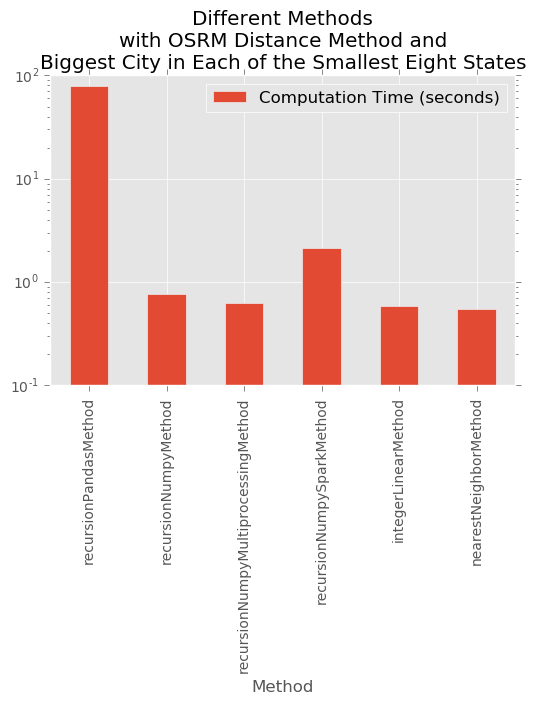

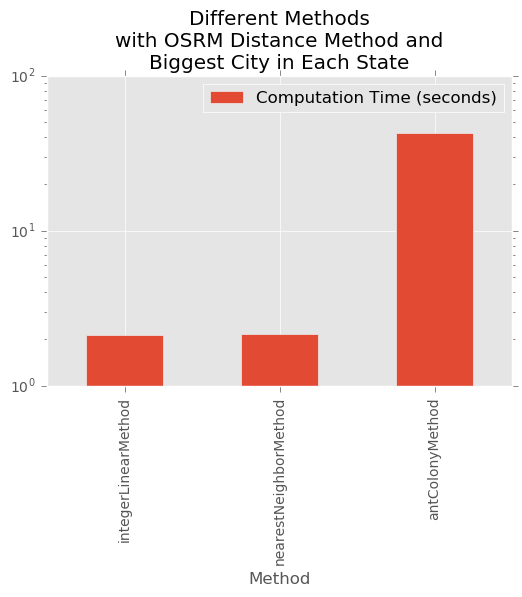

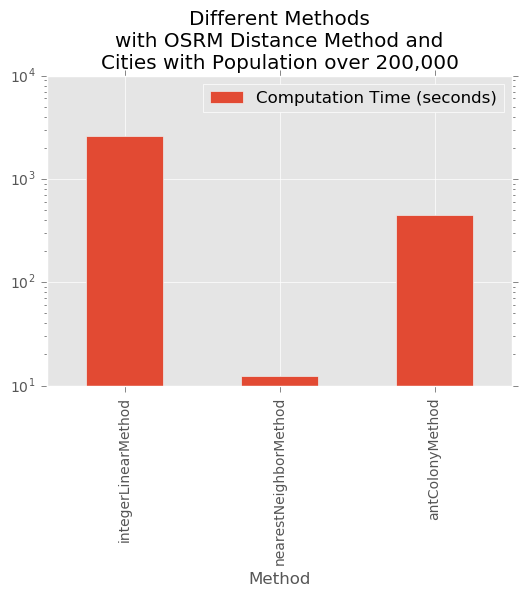

In [91]:
df[(df['City Selection'] == 'Biggest City in Each of the Smallest Eight States') & (df['Distance Method'] == 'distanceOSRM')].plot(x='Method', y='Computation Time (seconds)', kind='bar', logy=True, legend=True, title='Different Methods\nwith OSRM Distance Method and\nBiggest City in Each of the Smallest Eight States')
df[(df['City Selection'] == 'Biggest City in Each State') & (df['Distance Method'] == 'distanceOSRM')].plot(x='Method', y='Computation Time (seconds)', kind='bar', logy=True, legend=True, title='Different Methods\nwith OSRM Distance Method and\nBiggest City in Each State')
df[(df['City Selection'] == 'Cities with Population over 200,000') & (df['Distance Method'] == 'distanceOSRM')].plot(x='Method', y='Computation Time (seconds)', kind='bar', logy=True, legend=True, title='Different Methods\nwith OSRM Distance Method and\nCities with Population over 200,000')
pyplot.show()

## Results
To further expand on the idea that computation time for the brute force methods grows factorially, we can compute a solution for a varying number of cities and plot the computation time versus the number of cities. Given this information, we can estimate that computing a brute force answer for sixteen cities, Biggest City in Each State, would take approximately 267 x 13 x 14 x 15 x 16 = 11,662,560 seconds or about 135 days. The Integer Linear Programming method running with an optimized engine for these cities takes under one second.

In [92]:
results2 = []
for i in range(13):
    cities = citiesOver200000.head(i)
    cities.name = str(i)
    results2.append(travelingSalesperson(recursionNumpyMethod, distanceHaversine, cities))

df2 = pandas.DataFrame(results2)
df2

,City Selection,Computation Time (seconds),Cost (Euros),Distance Method,Method,Number of Cities,Route
0,0,0.00,0.00,distanceHaversine,recursionNumpyMethod,1,"[München (Munich), München (Munich)]"
1,1,0.00,34937.50,distanceHaversine,recursionNumpyMethod,2,"[München (Munich), Berlin, München (Munich)]"
2,2,0.00,47293.29,distanceHaversine,recursionNumpyMethod,3,"[München (Munich), Hamburg, Berlin, München (Munich)]"
3,3,0.00,47293.29,distanceHaversine,recursionNumpyMethod,3,"[München (Munich), Hamburg, Berlin, München (Munich)]"
4,4,0.00,54321.23,distanceHaversine,recursionNumpyMethod,4,"[München (Munich), Köln (Cologne), Hamburg, Berlin, München (Munich)]"
5,5,0.01,54355.74,distanceHaversine,recursionNumpyMethod,5,"[München (Munich), Frankfurt am Main, Köln (Cologne), Hamburg, Berlin, München (Munich)]"
6,6,0.01,55696.23,distanceHaversine,recursionNumpyMethod,6,"[München (Munich), Stuttgart, Frankfurt am Main, Köln (Cologne), Hamburg, Berlin, München (Munich)]"
7,7,0.01,56244.79,distanceHaversine,recursionNumpyMethod,7,"[München (Munich), Stuttgart, Frankfurt am Main, Köln (Cologne), Düsseldorf, Hamburg, Berlin, München (Munich)]"
8,8,0.04,56349.93,distanceHaversine,recursionNumpyMethod,8,"[München (Munich), Stuttgart, Frankfurt am Main, Köln (Cologne), Düsseldorf, Dortmund, Hamburg, Berlin, München (Munich)]"
9,9,0.27,56499.76,distanceHaversine,recursionNumpyMethod,9,"[München (Munich), Stuttgart, Frankfurt am Main, Köln (Cologne), Düsseldorf, Essen, Dortmund, Hamburg, Berlin, München (Munich)]"


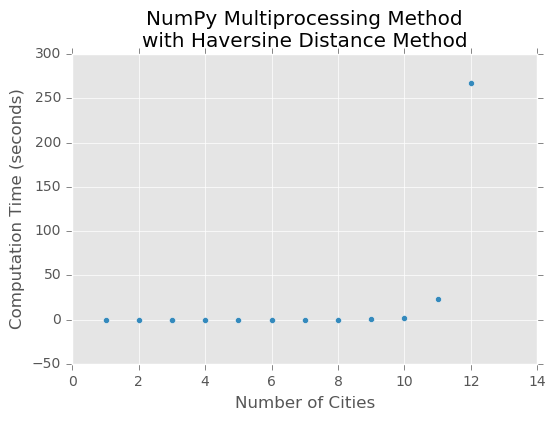

In [93]:
df2.plot(x='Number of Cities', y='Computation Time (seconds)', kind='scatter', legend=True, title='NumPy Multiprocessing Method\nwith Haversine Distance Method')
pyplot.show()

## Results
To conclude, our customer will want to see the route for our salesperson. Below is a map for each combination of cities, method, and distance method.

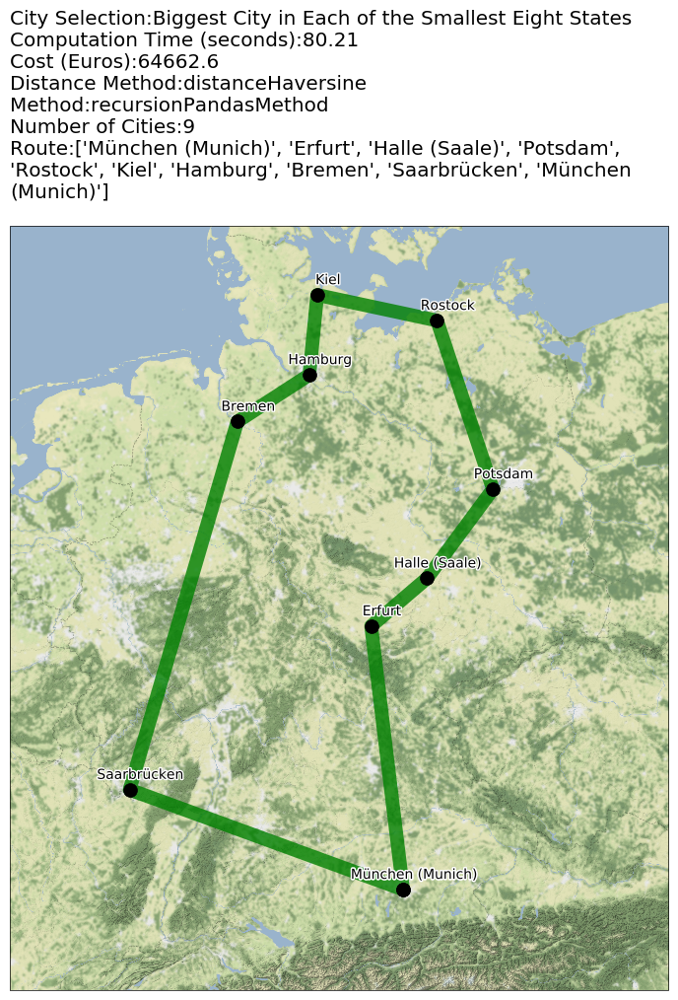

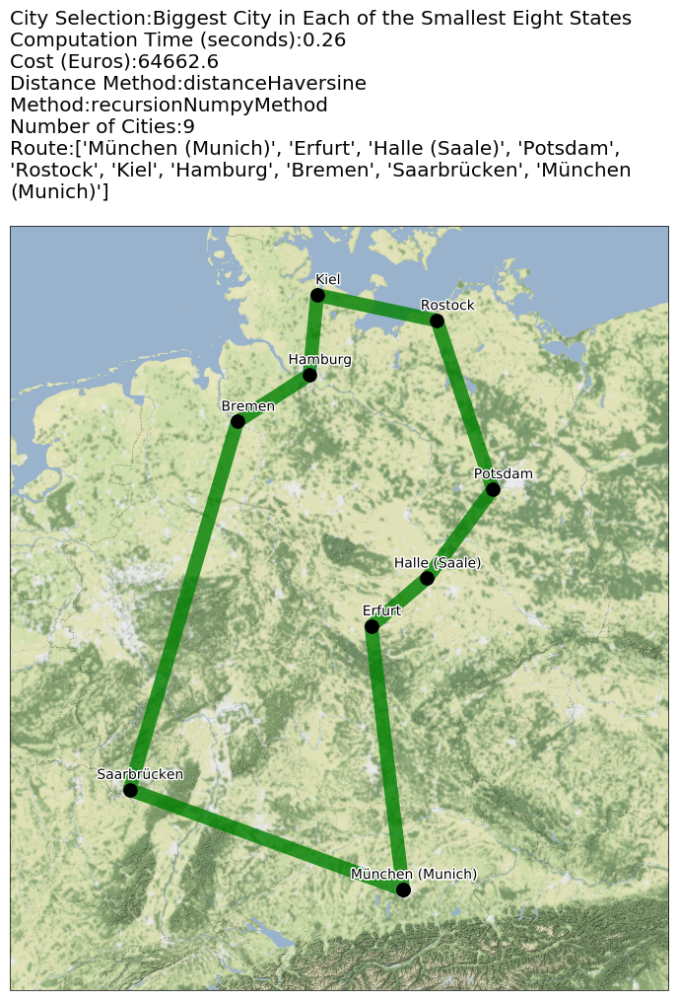

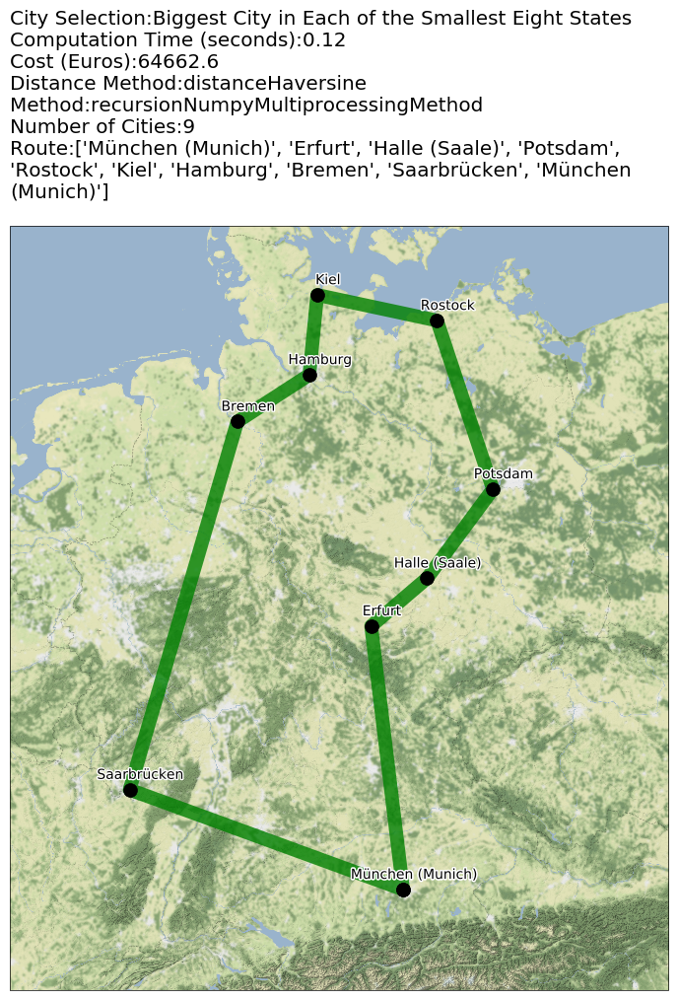

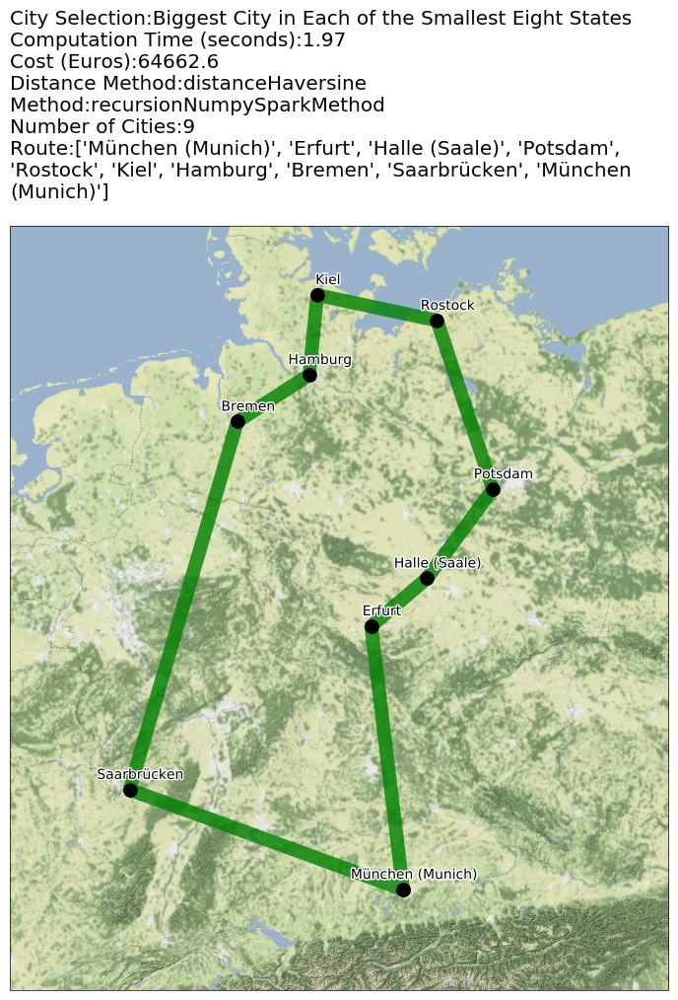

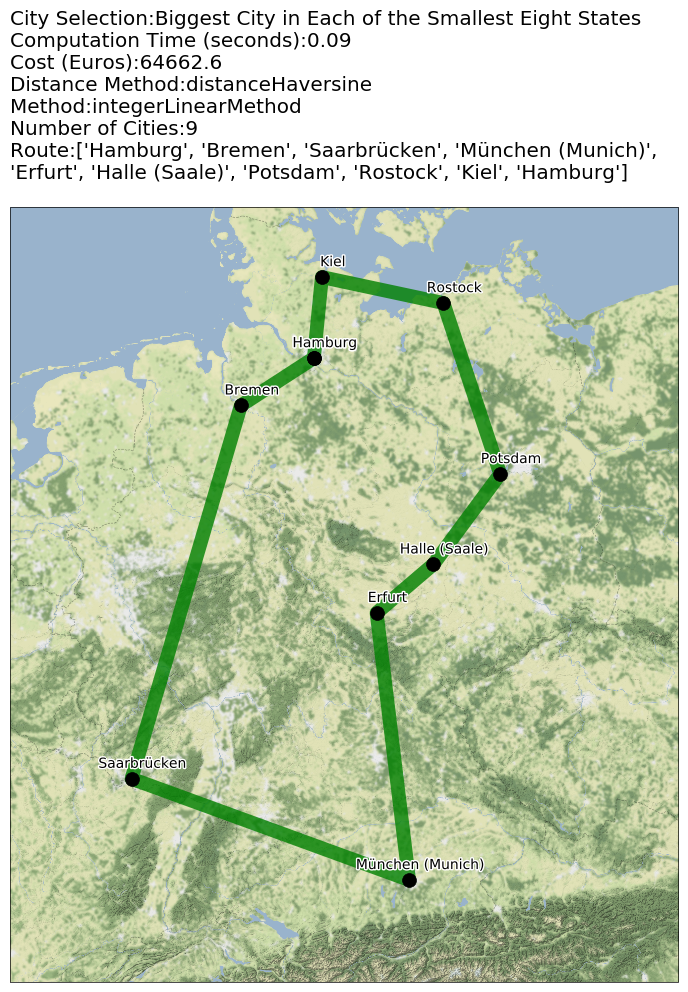

...

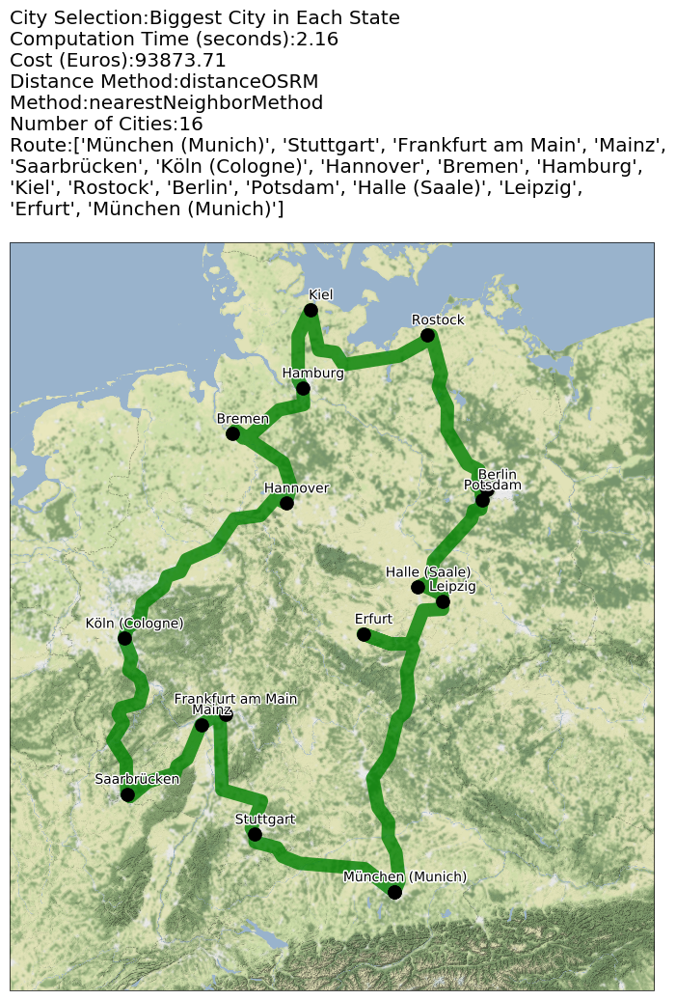

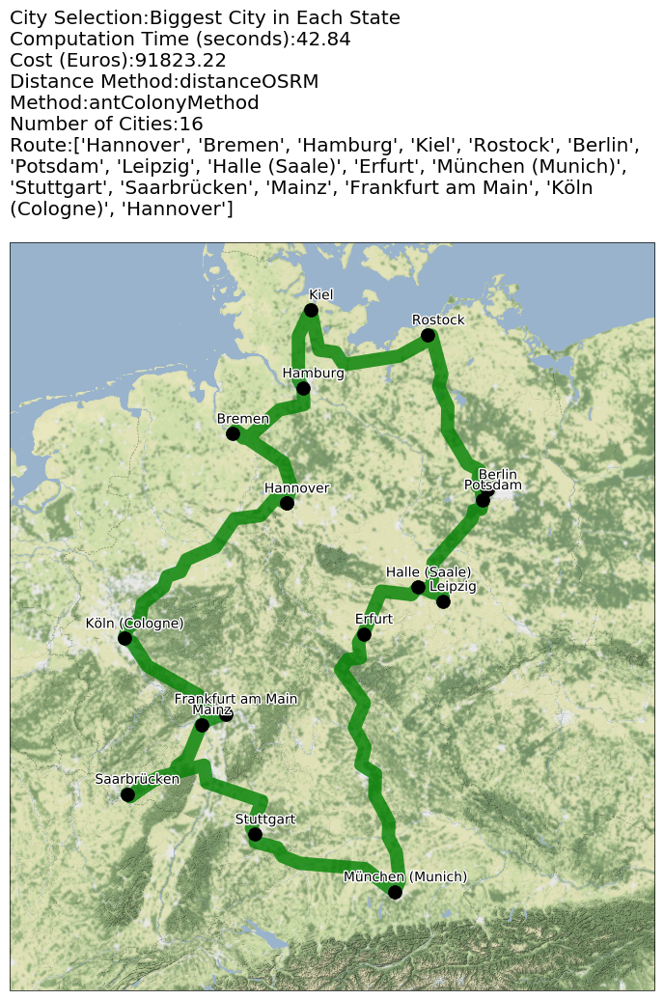

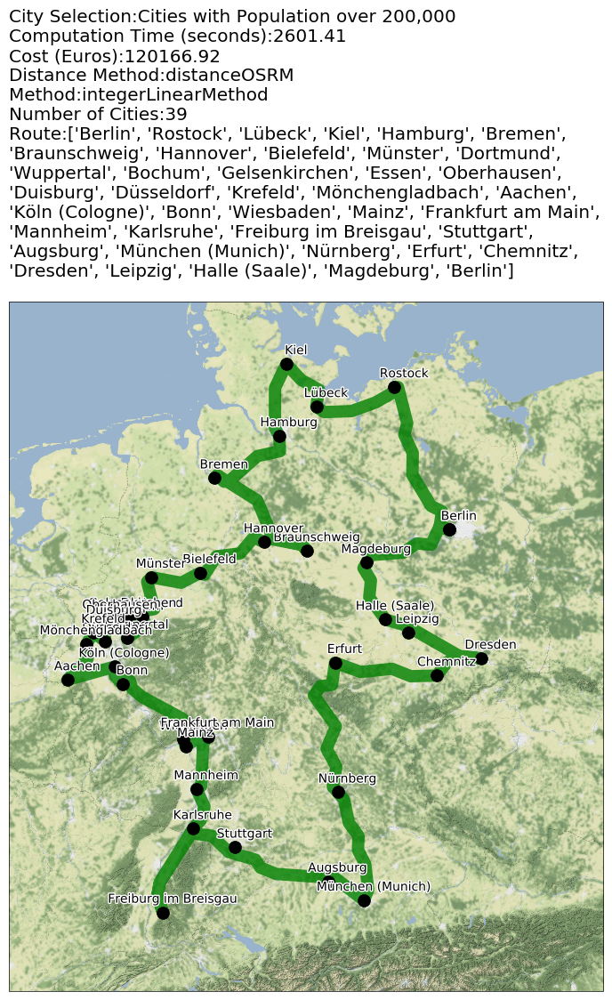

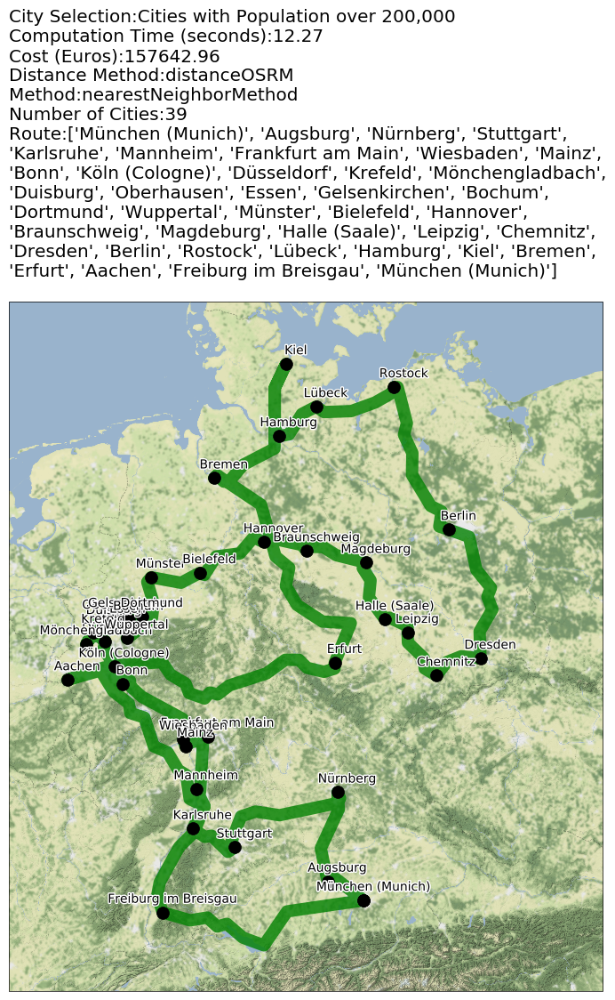

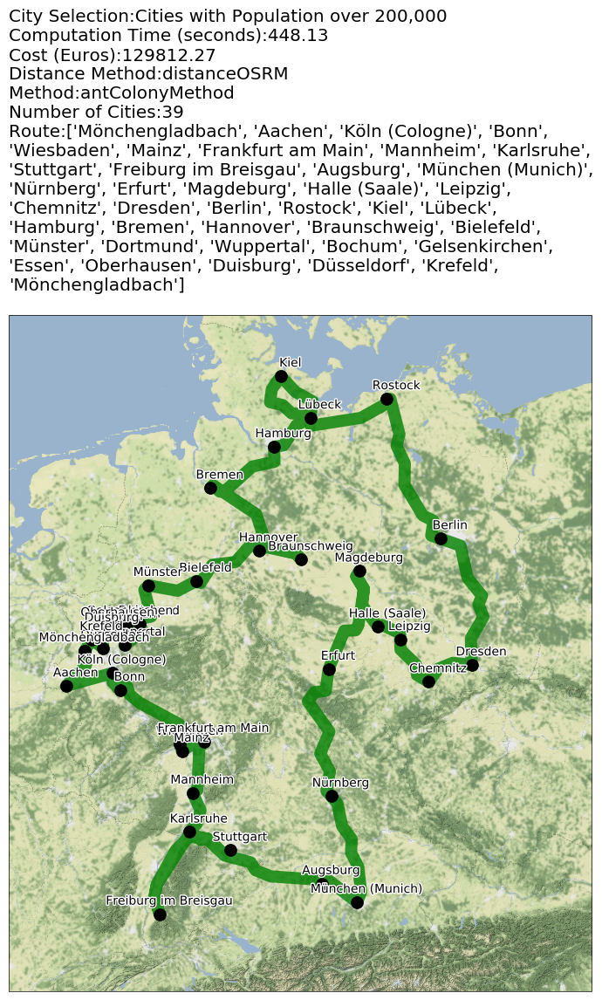

0     None
1     None
2     None
3     None
4     None
5     None
6     None
7     None
8     None
9     None
10    None
11    None
12    None
13    None
14    None
15    None
16    None
17    None
18    None
19    None
20    None
21    None
22    None
23    None
dtype: object

In [94]:
def plotCity(city, ax):
    ax.plot(city['geometry'].x, city['geometry'].y, marker='o', markersize=10, color='black', zorder=3)
    text = pyplot.annotate(s=city['city'], xy=(city['geometry'].x + 20000, city['geometry'].y + 20000), horizontalalignment='center', fontsize=10)
    text.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'), path_effects.Normal()])


def visualizePath(row, cities=citiesByPopulation, originCity='München (Munich)'):
    if originCity not in cities.City:
        cities = cities.append(citiesByPopulation.loc[originCity])
    fig = pyplot.figure(figsize=(12, 10))
    imagery = StamenTerrain()
    ax = fig.add_subplot(111, projection=imagery.crs)
    ax.set_extent((5, 16, 55, 47))
    ax.add_image(imagery, 8)
    if row['Distance Method'] == 'distanceHaversine':
        linestring = LineString(list(map(lambda x: (cities.loc[x]['longitude'], cities.loc[x]['latitude']), row['Route'])))
    elif row['Distance Method'] == 'distanceOSRM':
        routestring = reduce(lambda x,y: x + ';' + y, map(lambda x: str(cities.loc[x]['longitude']) + ',' + str(cities.loc[x]['latitude']), row['Route']))
        r = requests.get('http://localhost:5000/route/v1/driving/' + routestring + '?geometries=geojson')
        linestring = LineString(r.json()['routes'][0]['geometry']['coordinates'])
    gdf = geopandas.GeoDataFrame([{'geometry': linestring}], crs = {'init': 'epsg:4326'})
    gdf = gdf.to_crs({'init': 'epsg:3857'})
    gdf.plot(ax = ax, linewidth=10, solid_capstyle='round', alpha=.8, color='green', zorder=2)
    gdf = geopandas.GeoDataFrame(row['Route'], columns=['city'], crs = {'init': 'epsg:4326'})
    gdf.geometry = gdf.apply(lambda row: Point(cities.loc[row['city']]['longitude'], cities.loc[row['city']]['latitude']),axis=1)
    gdf = gdf.to_crs({'init': 'epsg:3857'})
    gdf.apply(partial(plotCity, ax=ax), axis=1)
    title = ''
    for i in row.index:
        title += fill(i + ':' + str(row[i])) + '\n'
    ax.set_title(title, loc='left')
    pyplot.show()


df.apply(lambda row: visualizePath(row), axis=1)